In [2]:
# imports
import pandas as pd
import altair as alt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn import metricsp

In [3]:
dwellings = pd.read_csv("dwellings_ml.csv")
dwellings_neighborhoods = pd.read_csv("dwellings_neighborhoods_ml.csv")

In [4]:
alt.data_transformers.disable_max_rows()
chart1 = alt.Chart(dwellings).mark_circle(size=60, clip=True).encode(
    alt.X('yrbuilt:Q',
        scale=alt.Scale(zero=False),
        title="Year Built"
    ),
    alt.Y('sprice:Q',
        scale=alt.Scale(domain=(0, 2500000)),
        title="Selling Price"    
    )
)


chart2 = alt.Chart(dwellings).mark_circle(size=60, clip=True).encode(
    alt.X('yrbuilt:Q',
        scale=alt.Scale(zero=False),
        title="Year Built"
    ),
    alt.Y('finbsmnt:Q',
        scale=alt.Scale(zero=False),
        title="Selling Price"    
    )
)

chart2



alt.Chart(...)

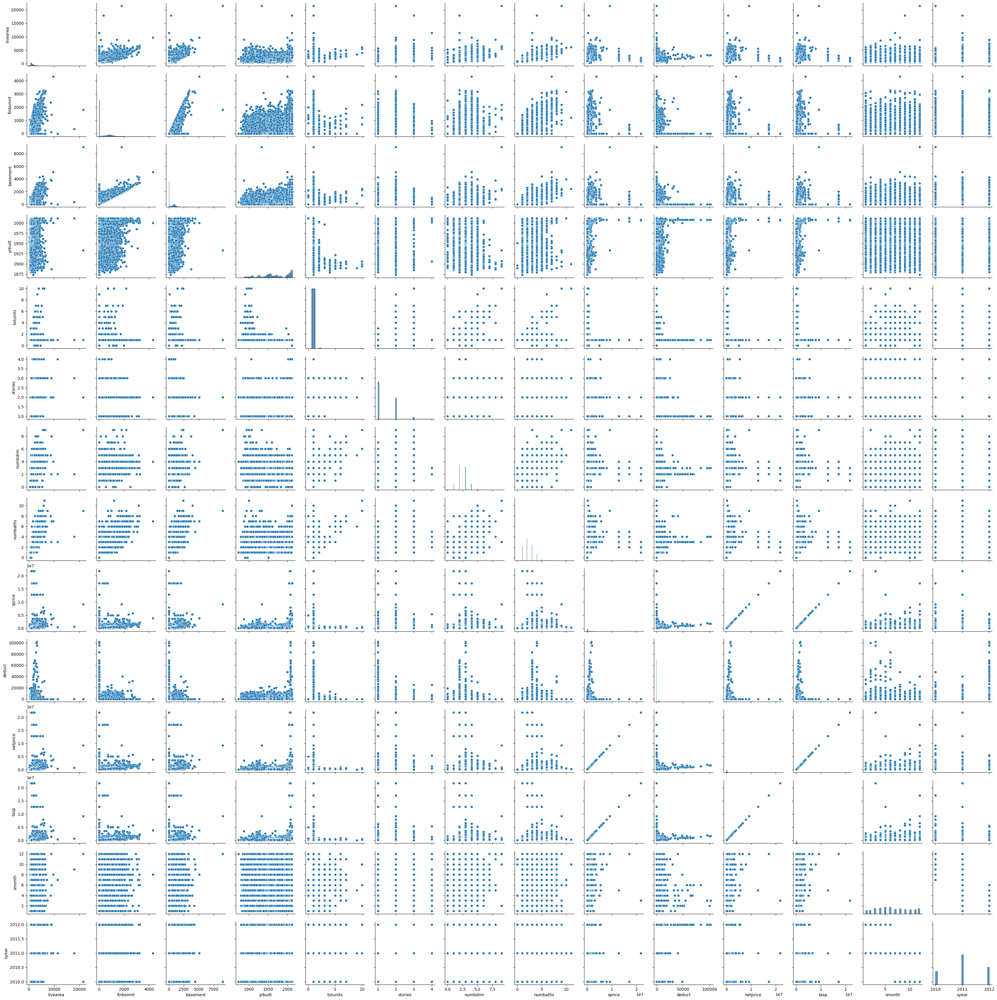

In [5]:
sns.pairplot(data=dwellings[["livearea", "finbsmnt", "basement", "yrbuilt", "totunits", "stories", "numbdrm", "numbaths", "sprice", "deduct", "netprice", "tasp", "smonth", "syear"]])


In [6]:
drop = ["before1980", "parcel_x", "parcel_y", "abstrprd", "yrbuilt", "status_I", "status_V", "qualified_U", "qualified_Q", "smonth", "syear", "tasp"]
x = dwellings
x = x.merge(dwellings_neighborhoods, how='left', left_index=True, right_index=True)
for col in drop:
    x = x.loc[:, x.columns != col]


In [7]:
y = dwellings["before1980"]

In [8]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = .33, random_state = 345)

In [9]:
classifier = RandomForestClassifier(random_state=345)
classifier.fit(x_train, y_train)


y_predictions = classifier.predict(x_test)
# metrics.accuracy_score(y_test, y_predictions)
# metrics.precision_score(y_test, y_predictions)
# metrics.recall_score(y_test, y_predictions)

importances = classifier.feature_importances_
importances


array([6.99304116e-02, 2.49077007e-02, 3.76552176e-02, 2.31851676e-03,
       5.51601961e-02, 2.21682455e-02, 2.17113264e-02, 6.50785093e-02,
       5.63637279e-02, 1.44739827e-02, 5.18270466e-02, 2.02645159e-02,
       5.50274472e-05, 0.00000000e+00, 1.83700635e-02, 1.36484993e-03,
       6.20079170e-03, 2.49865923e-02, 4.01495265e-02, 2.17508821e-03,
       1.11923538e-03, 4.42974190e-02, 6.61401640e-04, 1.35081817e-04,
       2.07463968e-02, 7.60678097e-03, 1.83857505e-05, 3.69401536e-04,
       1.13889657e-03, 1.34105960e-03, 1.70819470e-02, 1.28303838e-02,
       8.81424303e-03, 6.49173952e-02, 2.37864808e-04, 3.16553485e-04,
       2.70181151e-03, 2.79851664e-03, 6.02117979e-04, 2.59657988e-02,
       9.28255142e-03, 9.83317354e-03, 1.56674835e-02, 5.26304777e-03,
       1.80697848e-02, 3.41129665e-02, 4.46867316e-05, 8.41195493e-05,
       5.55778931e-04, 1.22437863e-06, 2.17950075e-05, 4.94675105e-05,
       2.39846591e-04, 8.49528998e-05, 7.96506182e-05, 8.42146392e-05,
      

In [10]:
feature_df = pd.DataFrame({'features':x.columns, 'importance':classifier.feature_importances_})

feature_df_small = (feature_df.query("importance >= 0.01")
    .sort_values(by='importance', ascending=False)
)

bars = alt.Chart(feature_df_small).mark_bar().encode(
    alt.X('importance:Q', title='Feature Importance'),
    alt.Y('features:O', sort=alt.EncodingSortField(field="features", op="count", order='ascending'), title='Features')
)

bars

alt.Chart(...)